In [78]:
import os
import numpy as np
import pandas as pd
import pprint

import pickle # Load refs and annotations
from typing import Any, Optional

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision.transforms as transforms
from torch.utils.data import DataLoader, TensorDataset

import torchvision
import torchmetrics


import pytorch_lightning as pl
from pytorch_lightning.utilities.types import STEP_OUTPUT

from transformers import T5Tokenizer, T5ForConditionalGeneration 

from tqdm import tqdm

from PIL import Image
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle

import clip
from ultralytics import YOLO


import torch
import clip
from PIL import Image, ImageDraw
import cv2
import numpy as np


import matplotlib.pyplot as plt
import torch
import numpy as np
import os
import json

from torch.utils.data import DataLoader
from torchvision import transforms
from PIL import Image, ImageDraw

import sklearn.metrics


In [49]:
%matplotlib inline

In [50]:
from torch.utils.data import Dataset

import json

class RefCOCOg(Dataset):
    """
    Args:
        dataset: a list of dictionaries containing:
        {
            'file_name': # path of the image, images will be loaded on the fly
            'caption': # referring caption
            'ann_id': # annotation ID (one per caption), taken from 'file_name'
            'bbox': # coordinates (xmin, ymin, xmax, ymax) of the bounding box
        }
    """
    def __init__(self, refs, annotations, split="train"):

        self.dataset = [{"file_name": os.path.join("./refcocog/images/", f'{"_".join(elem["file_name"].split("_")[:3])}.jpg'),
                            "caption": elem["sentences"][0]["raw"],
                            "ann_id": int(elem["file_name"].split("_")[3][:-4]),
                            "bbox": annotations[int(elem["file_name"].split("_")[3][:-4])]}
                        for elem in [d for d in refs if d["split"]==split]]

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, idx):
        return self.dataset[idx]

    def __call__(self, idx):
        print(json.dumps(self.dataset[idx], indent=4))

In [51]:
# Load refs and annotations
import pickle

with open("./refcocog/annotations/refs(umd).p", "rb") as fp:
  refs = pickle.load(fp)

# 'annotations' will be a dict object mapping the 'annotation_id' to the 'bbox' to make search faster
with open("./refcocog/annotations/instances.json", "rb") as fp:
  data = json.load(fp)
  annotations = dict(sorted({ann["id"]: ann["bbox"] for ann in data["annotations"]}.items()))

In [52]:
import matplotlib.pyplot as plt
import torch
import numpy as np
import os

from torch.utils.data import DataLoader
from torchvision import transforms
from PIL import Image, ImageDraw

def pad_image(image):
    """
    Performs bottom-right padding of the original image to 640x640 (max size of images in the dataset).
    Bottom-right padding prevents corruption of bounding boxes.

    ### Arguments
    image: a PIL.Image to transform
    """
    original_width, original_height = image.size
    padded_width, padded_height = 640, 640

    pad_width = padded_width - original_width
    pad_height = padded_height - original_height

    padded_image = Image.new(image.mode, (padded_width, padded_height), (0, 0, 0))
    padded_image.paste(image, (0, 0))

    return padded_image

def collate_fn(batch):
    images = []
    for sample in batch:
        image = Image.open(sample["file_name"]).convert("RGB")
        image = pad_image(image=image)
        images.append(transform(image))
    images = torch.stack(images, dim=0)

    data = {}
    for key in batch[0].keys():
        if key != "file_name":
            data[key] = [sample[key] for sample in batch]
    return images, data

transform = transforms.Compose([
    transforms.ToTensor(),
])

# create dataset and dataloader
dataset = RefCOCOg(refs, annotations, split="test")
print(dataset[0])
print("---------------------------------------------------")
#plt.imshow(Image.open(dataset[2]["file_name"]))
dataloader = DataLoader(dataset, batch_size=1, collate_fn=collate_fn)

{'file_name': './refcocog/images/COCO_train2014_000000380440.jpg', 'caption': 'the man in yellow coat', 'ann_id': 491042, 'bbox': [374.31, 65.06, 136.04, 201.94]}
---------------------------------------------------


## Detect bboxes

Using cache found in /Users/edoardomaines/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2023-8-29 Python-3.10.9 torch-2.0.1 CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients
Adding AutoShape... 



 CAPTION:  the man in yellow coat
RESULTS:  [[     376.61      67.179      511.14      262.76     0.93059           0]
 [     230.68      43.151      371.29      307.86     0.93046           0]
 [     244.57      257.02       377.8      343.93     0.70347          30]
 [     346.71      212.95      518.61      268.03     0.44743          30]]


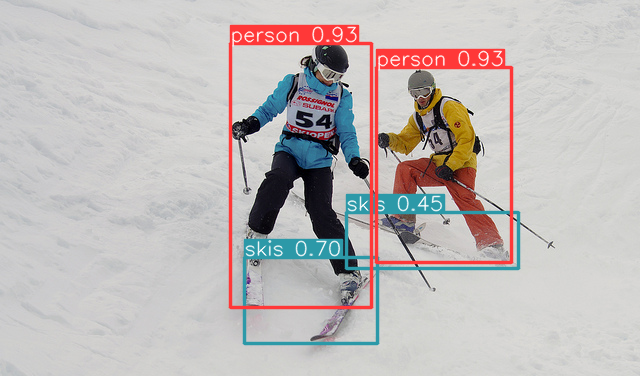

In [53]:
# Models
yolo_model = torch.hub.load('ultralytics/yolov5', 'yolov5s', pretrained=True)

# Images
img = dataset[0]['file_name']
# Query
q = dataset[0]['caption']

# Inference
results = yolo_model(img)

# Results
print("\n CAPTION: ", q)
print("RESULTS: ", results.xyxy[0].cpu().numpy())
results.show()
#      xmin    ymin    xmax   ymax  confidence  class    name

## Choose best bbox

In [54]:
device = "cuda" if torch.cuda.is_available() else "cpu"
model, preprocess = clip.load("RN50", device=device)
text = clip.tokenize(q).to(device)

In [55]:
best_bbox = []
max_prob = 0
for bbox in results.xyxy[0].cpu().numpy():
    print(bbox)
    temp = cv2.imread(dataset[0]['file_name'])
    #print(temp)
    image = np.zeros((temp.shape[0], temp.shape[1], temp.shape[2]), dtype=np.uint8)
    image[int(bbox[1]):int(bbox[3]), int(bbox[0]):int(bbox[2])] = temp[int(bbox[1]):int(bbox[3]), int(bbox[0]):int(bbox[2])]
    image = preprocess(Image.fromarray(image)).unsqueeze(0).to(device)

    with torch.no_grad():
        image_features = model.encode_image(image)
        text_features = model.encode_text(text)
        
        logits_per_image, logits_per_text = model(image, text)
        prob = logits_per_text.cpu().numpy()[0][0]
        
        if prob > max_prob:
            #print("ciao")
            max_prob = prob
            best_bbox = bbox


[     376.61      67.179      511.14      262.76     0.93059           0]
[     230.68      43.151      371.29      307.86     0.93046           0]
[     244.57      257.02       377.8      343.93     0.70347          30]
[     346.71      212.95      518.61      268.03     0.44743          30]


In [56]:
source_img = Image.open(img).convert("RGBA")
draw = ImageDraw.Draw(source_img)
print(best_bbox)
draw.rectangle([best_bbox[0], best_bbox[1], best_bbox[2], best_bbox[3]],outline='green', width=3)

#prova per capire posizione punti
draw.rectangle([374.31, 65.06, 374.31+136.04, 65.06+201.94], outline='red', width=3)

source_img.save("gino.png")

#print(dataset[0])
print(dataset[0]['caption'])

[     230.68      43.151      371.29      307.86     0.93046           0]
the man in yellow coat


## lets do this for multiple images

In [57]:
a = 0
images = []
best_bboxes = []
captions = []

for elem in dataset:
    max_prob = 0
    print(elem)
    img = dataset[a]['file_name']
    images.append(img)
    # Query
    q = dataset[a]['caption']
    results = yolo_model(img)
    captions.append(q)
    
    for bbox in results.xyxy[0].cpu().numpy():
        #print(bbox)
        temp = cv2.imread(dataset[0]['file_name'])
        #print(temp)
        image = np.zeros((temp.shape[0], temp.shape[1], temp.shape[2]), dtype=np.uint8)
        image[int(bbox[1]):int(bbox[3]), int(bbox[0]):int(bbox[2])] = temp[int(bbox[1]):int(bbox[3]), int(bbox[0]):int(bbox[2])]
        image = preprocess(Image.fromarray(image)).unsqueeze(0).to(device)

        with torch.no_grad():
            image_features = model.encode_image(image)
            text_features = model.encode_text(text)
            
            logits_per_image, logits_per_text = model(image, text)
            prob = logits_per_text.cpu().numpy()[0][0]
            #print("dio " + str(prob))
            if prob > max_prob:
                #print("ciao")
                max_prob = prob
                best_bbox = bbox
    a += 1
    max_prob = 0
    best_bboxes.append(best_bbox)
    if a==50:
        break

{'file_name': './refcocog/images/COCO_train2014_000000380440.jpg', 'caption': 'the man in yellow coat', 'ann_id': 491042, 'bbox': [374.31, 65.06, 136.04, 201.94]}
{'file_name': './refcocog/images/COCO_train2014_000000419645.jpg', 'caption': 'There is red colored truck in between the other trucks', 'ann_id': 398406, 'bbox': [93.95, 83.29, 504.61, 290.57]}
{'file_name': './refcocog/images/COCO_train2014_000000478885.jpg', 'caption': 'A apple desktop computer', 'ann_id': 124383, 'bbox': [338.8, 82.19, 147.34, 157.37]}
{'file_name': './refcocog/images/COCO_train2014_000000323240.jpg', 'caption': 'A girl wearing glasses and a pink shirt', 'ann_id': 192943, 'bbox': [45.2, 166.76, 147.45, 179.73]}
{'file_name': './refcocog/images/COCO_train2014_000000041700.jpg', 'caption': 'WOMAN IN COVERALLS', 'ann_id': 197196, 'bbox': [496.24, 82.81, 82.8, 168.71]}
{'file_name': './refcocog/images/COCO_train2014_000000274266.jpg', 'caption': 'A man standing next to a young girl on a grassy hillside', 'ann_

In [58]:
ground_bbox = []
dataset[0]['bbox']
a = 0

for elem in dataset:
    ground_bbox.append(elem['bbox'])
    a += 1
    if a > 50: 
        break   

print(ground_bbox)

[[374.31, 65.06, 136.04, 201.94], [93.95, 83.29, 504.61, 290.57], [338.8, 82.19, 147.34, 157.37], [45.2, 166.76, 147.45, 179.73], [496.24, 82.81, 82.8, 168.71], [375.98, 196.78, 61.71, 178.22], [39.28, 157.15, 255.05, 196.25], [182.85, 191.93, 100.03, 155.69], [40.36, 209.01, 188.83, 429.55], [305.65, 213.04, 333.63, 198.03], [392.41, 187.79, 184.67, 213.14], [56.13, 169.4, 582.37, 256.6], [349.25, 251.88, 150.75, 116.68], [325.54, 311.24, 154.46, 159.08], [227.73, 80.81, 370.99, 341.6], [62.28, 142.57, 205.15, 337.43], [328.15, 324.19, 182.43, 74.75], [353.19, 182.13, 141.78, 188.76], [159.87, 268.35, 244.1, 60.83], [2.88, 124.74, 635.22, 297.46], [223.56, 240.49, 150.63, 101.85], [137.29, 269.85, 171.06, 166.52], [263.92, 258.96, 176.45, 91.72], [118.21, 66.1, 194.91, 113.01], [256.16, 401.06, 139.29, 116.22], [194.87, 215.48, 211.0, 202.63], [144.26, 140.35, 128.98, 288.65], [198.33, 216.05, 185.17, 191.11], [303.75, 72.88, 246.76, 156.29], [320.02, 117.7, 250.53, 248.7], [173.54, 4

In [120]:
def plot_image_bbox(boxes, images, captions, ground):
      """Plot the images with the boxes"""
      iter = 0
      iou_tot = 0
      true_pos = 0
      false_pos = 0
      false_neg = 0
      threshold = 0.5

      for bbox, image, c, gbox in zip(boxes, images, captions, ground):
            # Create figure and axes
            _, ax = plt.subplots()
            image = Image.open(image)#.convert("RGBA")
            #image.show()

            # Display the image
                              
            ax.imshow(image)

            # Create a Rectangle patch
            
            # predicted bbox --> x1, y1, x2, y2
            x_min_1, y_min_1, x_max_1, y_max_1, confidence, classe = bbox
            box1 = Rectangle((x_min_1, y_min_1), x_max_1-x_min_1, y_max_1-y_min_1, linewidth=4, edgecolor='r', facecolor='none')
            ax.add_patch(box1)


            # ground bbox --> x, y, width, height
            x_min_2, y_min_2, width, height = gbox
            box2 = Rectangle((x_min_2, y_min_2), width, height, linewidth=4, edgecolor='g', facecolor='none')
            ax.add_patch(box2)

            
            #IoU
            x_overlap = max(0, min(box1.get_x() + box1.get_width(), box2.get_x() + box2.get_width()) - max(box1.get_x(), box2.get_x()))
            y_overlap = max(0, min(box1.get_y() + box1.get_height(), box2.get_y() + box2.get_height()) - max(box1.get_y(), box2.get_y()))
            intersection_area = x_overlap * y_overlap
            union_area = box1.get_width() * box1.get_height() + box2.get_width() * box2.get_height() - intersection_area
            iou = round(intersection_area / union_area, 3)
            iter +=1

            #True positive, false positive and false negative 
            iou_tot += iou
            if (iou >= threshold):
                  true_pos+=1
            if (iou < threshold):
                  false_pos+=1
            if (iou==0):
                  false_neg+=1

            #localization accuracy, Semantic similarity, Grounding accuracy(recall)

            ax.axes.xaxis.set_visible(False)
            ax.axes.yaxis.set_visible(False)

            plt.title(c)

            plt.show()

            #Show all the metrics
            print("Intersection over Union (IoU): ", iou)
      #print(true_pos, false_pos, false_neg)
      print("Total Intersection over Union (IoU): ", round(iou_tot/iter, 3))
      print("Total Precision: ", round (true_pos/(true_pos+false_pos), 3))
      print("Total Recall: ", round(true_pos/(true_pos+false_neg), 2))


B1:  [230.67886, 43.15132, 140.6148, 264.713]
B2:  [374.31, 65.06, 136.04, 201.94]


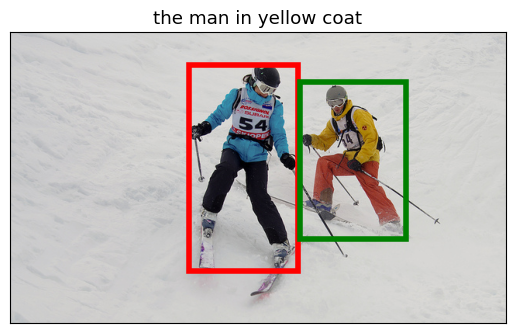

Intersection over Union (IoU):  0.0
B1:  [74.85309, 73.893265, 528.95264, 299.3567]
B2:  [93.95, 83.29, 504.61, 290.57]


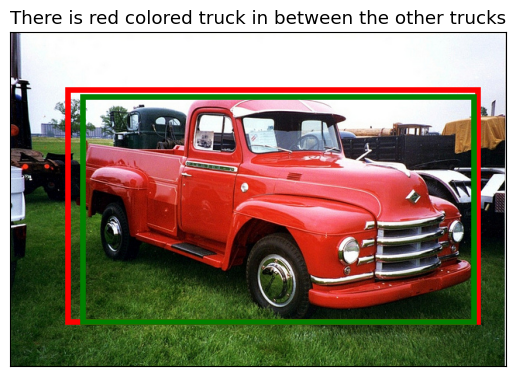

Intersection over Union (IoU):  0.922
B1:  [232.15106, 69.75704, 115.637024, 118.887215]
B2:  [338.8, 82.19, 147.34, 157.37]


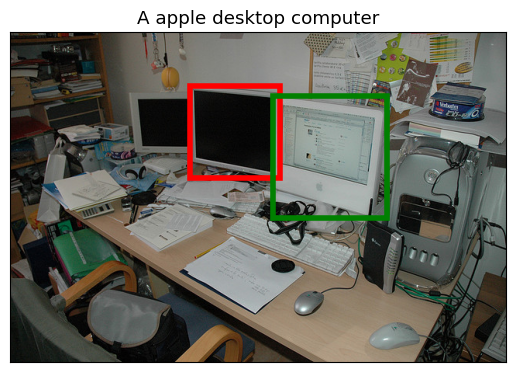

Intersection over Union (IoU):  0.027
B1:  [239.24365, 155.72388, 59.704468, 68.528076]
B2:  [45.2, 166.76, 147.45, 179.73]


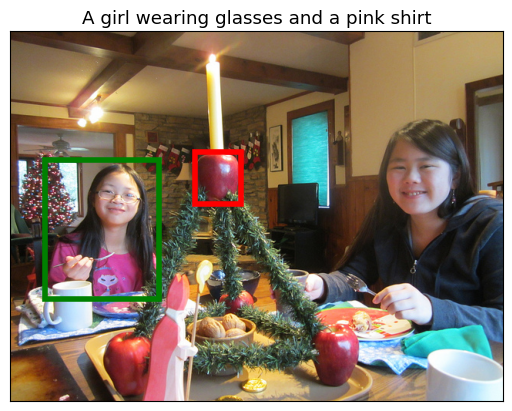

Intersection over Union (IoU):  0.0
B1:  [252.874, 92.49767, 73.31726, 141.01025]
B2:  [496.24, 82.81, 82.8, 168.71]


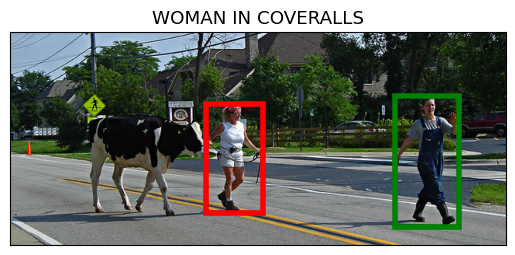

Intersection over Union (IoU):  0.0
B1:  [375.2822, 196.02373, 64.389984, 178.69182]
B2:  [375.98, 196.78, 61.71, 178.22]


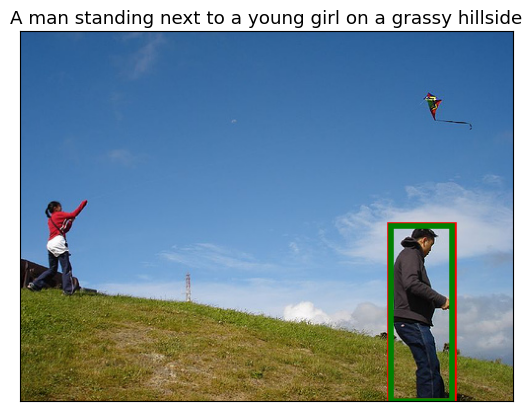

Intersection over Union (IoU):  0.953
B1:  [214.36806, 306.8243, 122.02794, 69.49353]
B2:  [39.28, 157.15, 255.05, 196.25]


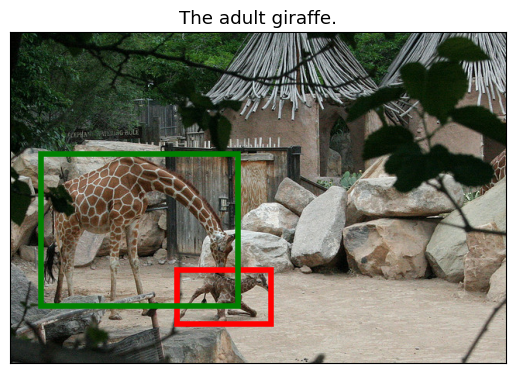

Intersection over Union (IoU):  0.068
B1:  [185.56232, 191.50182, 85.56534, 148.01997]
B2:  [182.85, 191.93, 100.03, 155.69]


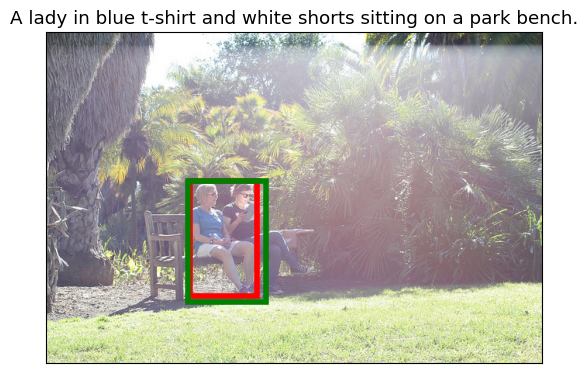

Intersection over Union (IoU):  0.809
B1:  [128.12144, 2.350235, 337.53046, 446.1761]
B2:  [40.36, 209.01, 188.83, 429.55]


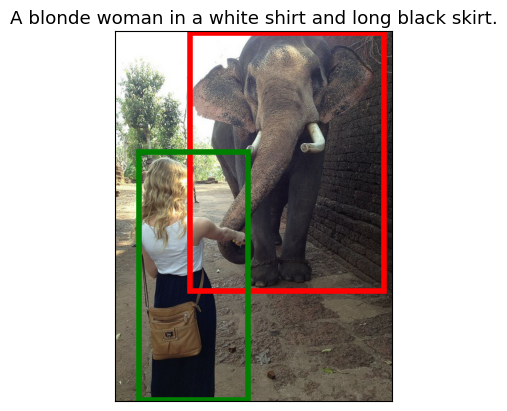

Intersection over Union (IoU):  0.117
B1:  [302.3921, 216.29236, 337.6079, 194.60535]
B2:  [305.65, 213.04, 333.63, 198.03]


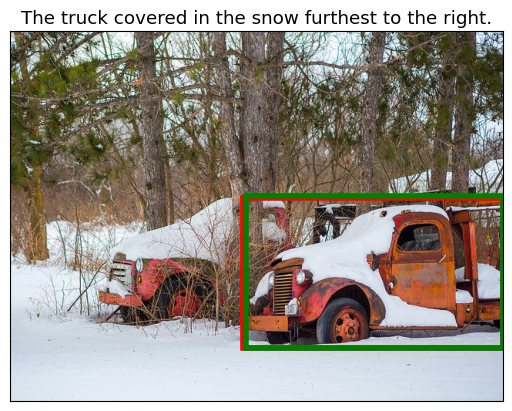

Intersection over Union (IoU):  0.971
B1:  [396.26517, 191.44527, 182.2861, 207.47417]
B2:  [392.41, 187.79, 184.67, 213.14]


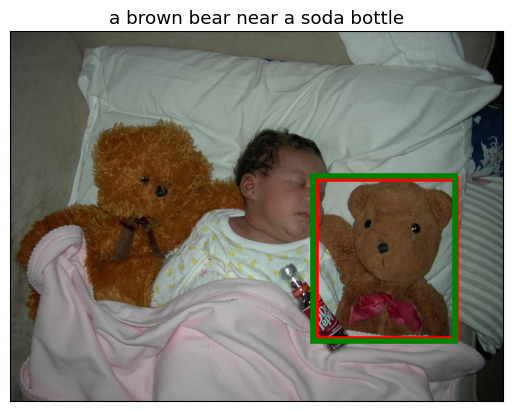

Intersection over Union (IoU):  0.946
B1:  [244.64807, 90.87977, 119.96454, 181.27179]
B2:  [56.13, 169.4, 582.37, 256.6]


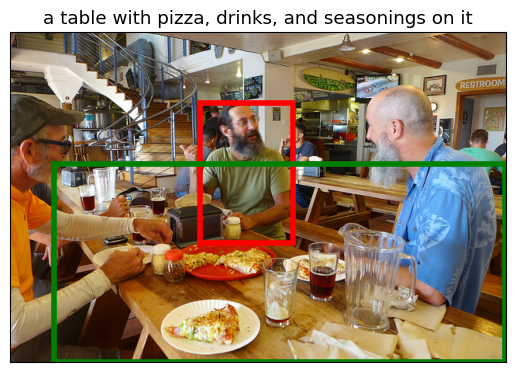

Intersection over Union (IoU):  0.078
B1:  [159.54305, 73.41618, 149.88841, 250.10118]
B2:  [349.25, 251.88, 150.75, 116.68]


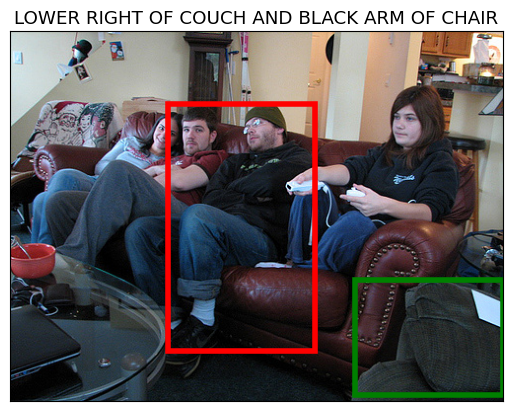

Intersection over Union (IoU):  0.0
B1:  [184.53925, 99.634865, 153.63959, 160.62164]
B2:  [325.54, 311.24, 154.46, 159.08]


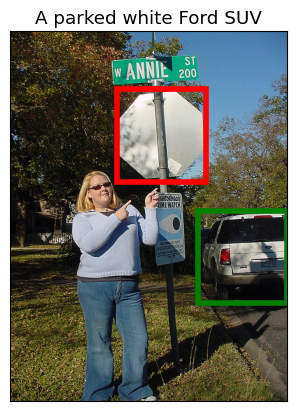

Intersection over Union (IoU):  0.0
B1:  [187.36882, 67.66527, 143.02498, 120.63132]
B2:  [227.73, 80.81, 370.99, 341.6]


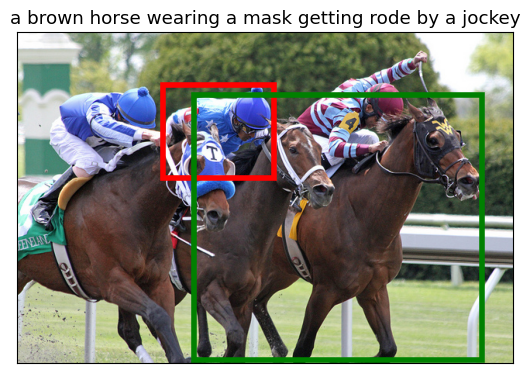

Intersection over Union (IoU):  0.083
B1:  [249.84567, 124.394806, 174.1734, 351.57867]
B2:  [62.28, 142.57, 205.15, 337.43]


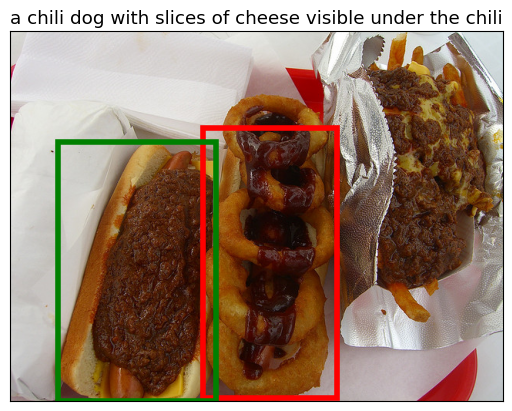

Intersection over Union (IoU):  0.047
B1:  [371.31454, 80.00827, 110.02075, 278.74023]
B2:  [328.15, 324.19, 182.43, 74.75]


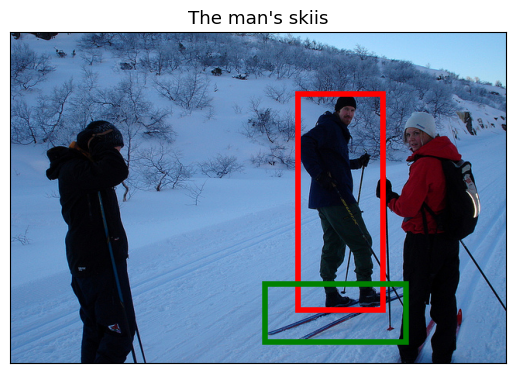

Intersection over Union (IoU):  0.094
B1:  [352.6462, 181.76082, 144.61298, 193.23918]
B2:  [353.19, 182.13, 141.78, 188.76]


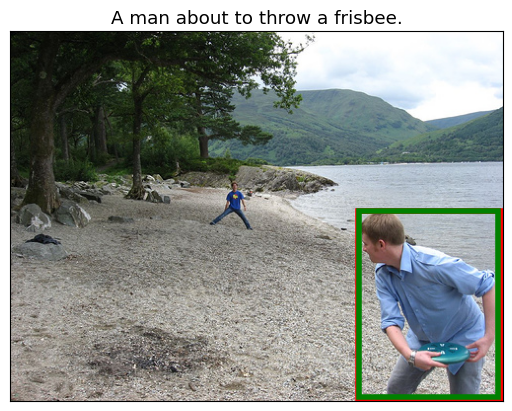

Intersection over Union (IoU):  0.958
B1:  [291.53378, 148.86491, 27.286255, 25.92418]
B2:  [159.87, 268.35, 244.1, 60.83]


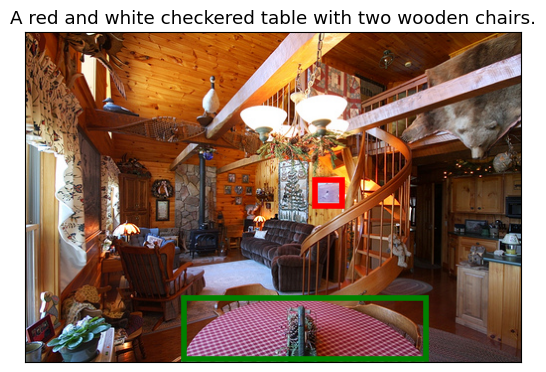

Intersection over Union (IoU):  0.0
B1:  [8.653473, 163.11964, 628.54663, 263.88037]
B2:  [2.88, 124.74, 635.22, 297.46]


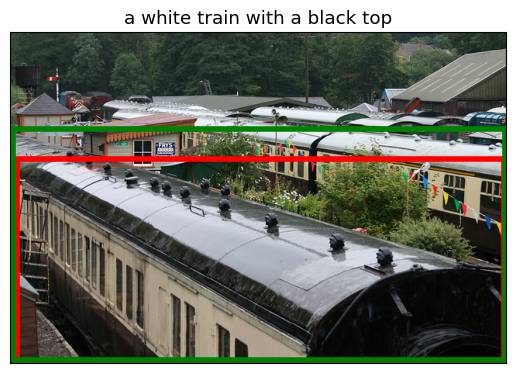

Intersection over Union (IoU):  0.848
B1:  [300.8947, 190.53172, 46.24182, 65.885025]
B2:  [223.56, 240.49, 150.63, 101.85]


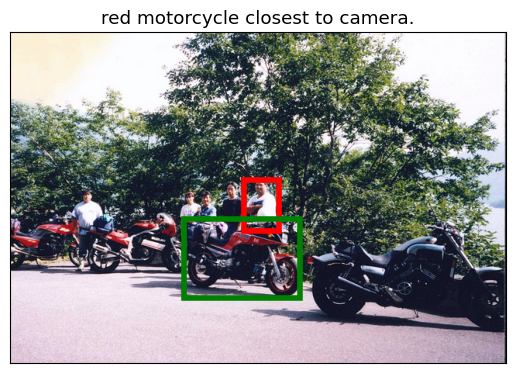

Intersection over Union (IoU):  0.042
B1:  [159.93375, 0.7162323, 277.68634, 134.65762]
B2:  [137.29, 269.85, 171.06, 166.52]


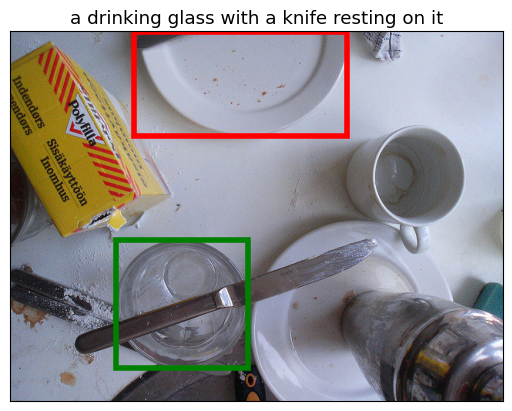

Intersection over Union (IoU):  0.0
B1:  [412.07623, 164.19604, 26.033936, 82.58249]
B2:  [263.92, 258.96, 176.45, 91.72]


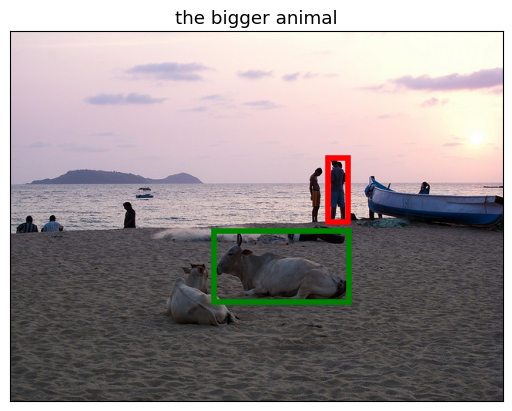

Intersection over Union (IoU):  0.0
B1:  [131.59395, 68.73043, 183.62569, 116.98968]
B2:  [118.21, 66.1, 194.91, 113.01]


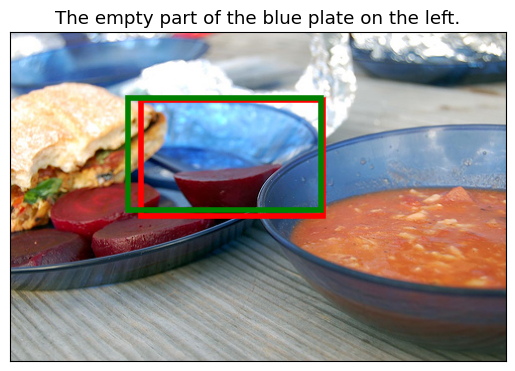

Intersection over Union (IoU):  0.854
B1:  [259.50577, 139.93576, 88.016235, 120.8714]
B2:  [256.16, 401.06, 139.29, 116.22]


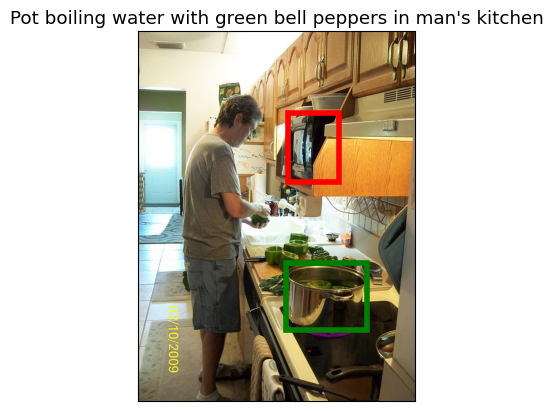

Intersection over Union (IoU):  0.0
B1:  [351.04993, 52.031487, 195.6626, 193.75027]
B2:  [194.87, 215.48, 211.0, 202.63]


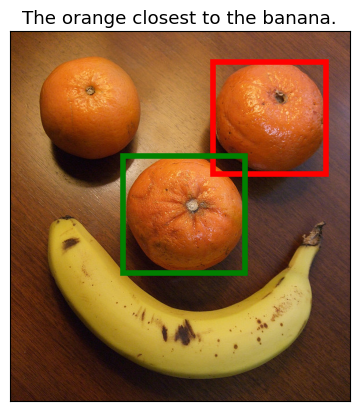

Intersection over Union (IoU):  0.021
B1:  [143.93678, 140.13324, 139.96269, 284.3662]
B2:  [144.26, 140.35, 128.98, 288.65]


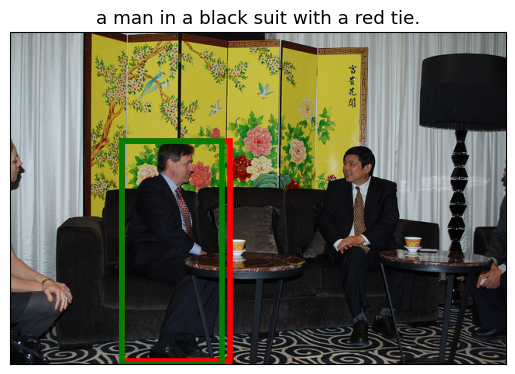

Intersection over Union (IoU):  0.908
B1:  [331.7256, 44.29597, 80.641785, 49.467518]
B2:  [198.33, 216.05, 185.17, 191.11]


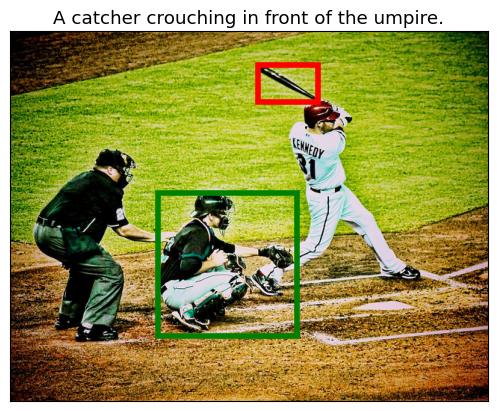

Intersection over Union (IoU):  0.0
B1:  [319.0726, 73.97457, 224.71414, 159.87582]
B2:  [303.75, 72.88, 246.76, 156.29]


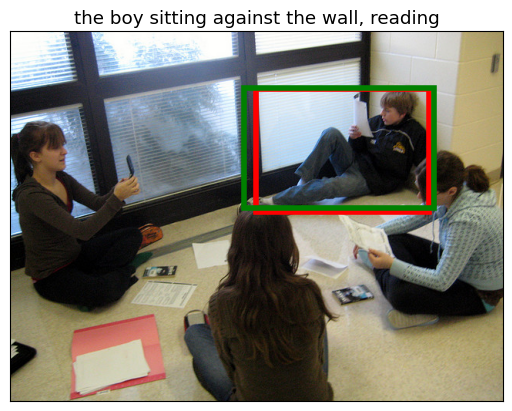

Intersection over Union (IoU):  0.88
B1:  [150.69644, 81.76115, 236.3529, 177.38177]
B2:  [320.02, 117.7, 250.53, 248.7]


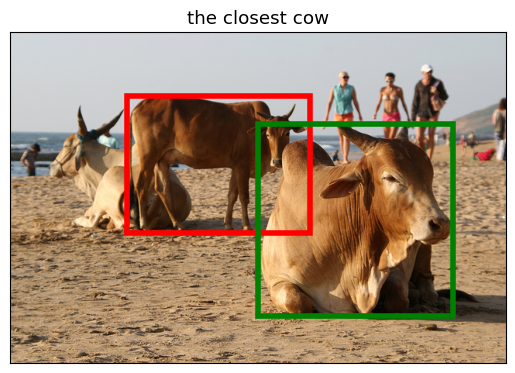

Intersection over Union (IoU):  0.1
B1:  [11.475952, 78.035065, 457.44073, 426.41638]
B2:  [173.54, 45.12, 303.73, 141.38]


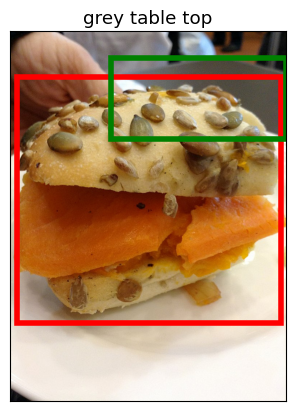

Intersection over Union (IoU):  0.156
B1:  [26.65036, 119.62479, 513.17847, 148.00006]
B2:  [81.18, 115.4, 450.79, 154.72]


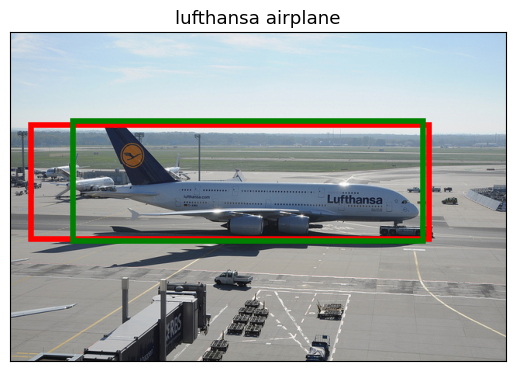

Intersection over Union (IoU):  0.845
B1:  [254.58685, 140.54634, 214.42554, 457.78235]
B2:  [33.12, 78.85, 303.88, 181.46]


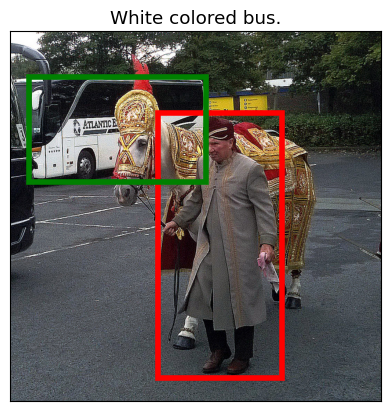

Intersection over Union (IoU):  0.069
B1:  [253.04965, 205.4425, 137.77618, 79.37787]
B2:  [132.82, 214.35, 251.45, 307.43]


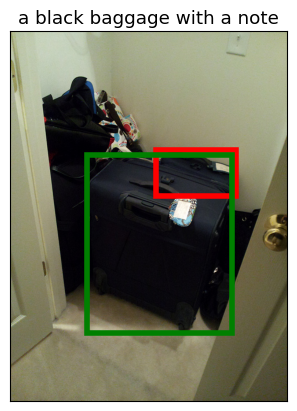

Intersection over Union (IoU):  0.117
B1:  [85.33864, 159.01962, 265.5398, 89.30588]
B2:  [0.0, 311.16, 637.48, 168.27]


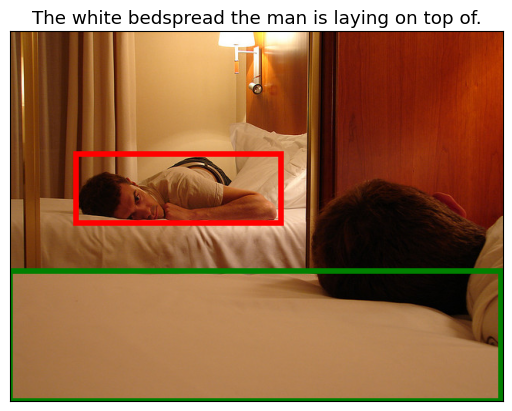

Intersection over Union (IoU):  0.0
B1:  [280.19125, 143.76114, 148.25928, 127.60608]
B2:  [203.42, 158.89, 182.78, 126.97]


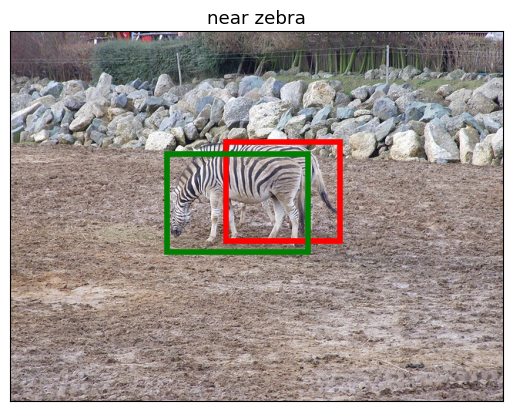

Intersection over Union (IoU):  0.395
B1:  [122.53337, 24.09224, 284.35608, 291.18854]
B2:  [361.35, 157.15, 267.5, 162.88]


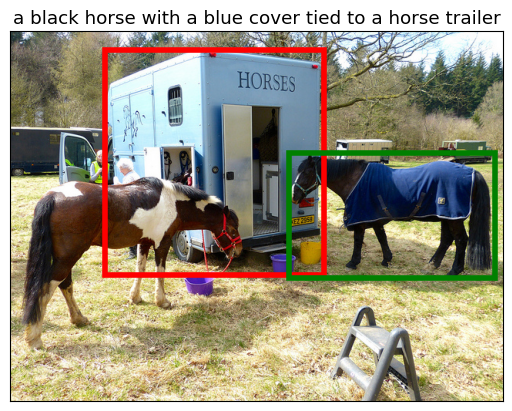

Intersection over Union (IoU):  0.06
B1:  [260.17072, 176.26167, 246.9914, 260.94147]
B2:  [294.08, 178.11, 214.98, 256.48]


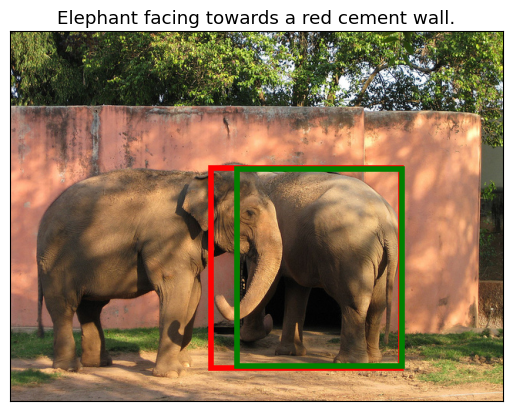

Intersection over Union (IoU):  0.842
B1:  [225.72894, 86.881004, 127.0383, 90.00225]
B2:  [405.88, 51.22, 94.06, 312.84]


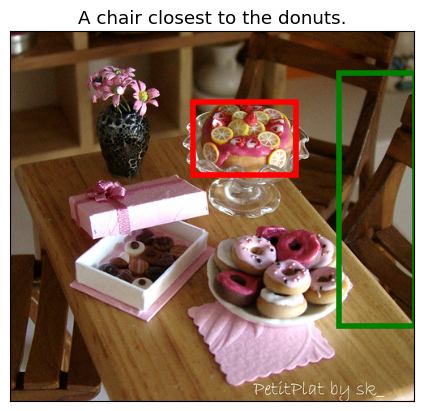

Intersection over Union (IoU):  0.0
B1:  [191.78757, 116.92514, 155.55487, 138.13461]
B2:  [356.15, 75.63, 224.03, 219.25]


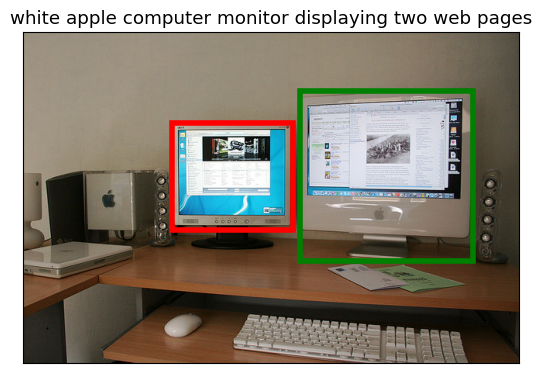

Intersection over Union (IoU):  0.0
B1:  [0.47562408, 311.56326, 160.70541, 149.80066]
B2:  [337.36, 0.12, 229.46, 184.81]


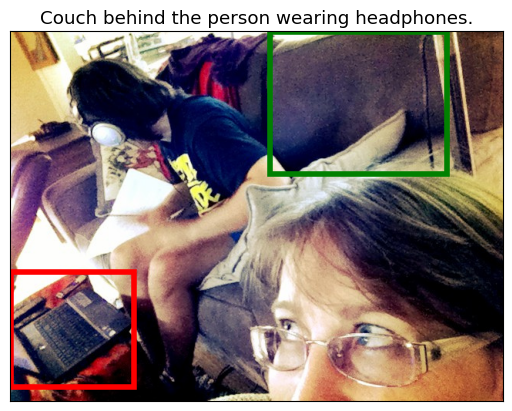

Intersection over Union (IoU):  0.0
B1:  [379.6852, 163.26135, 67.0426, 176.10504]
B2:  [0.96, 67.97, 190.5, 272.83]


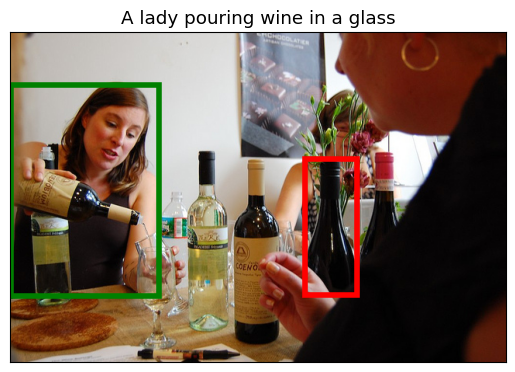

Intersection over Union (IoU):  0.0
B1:  [303.87128, 119.3407, 149.5434, 99.04944]
B2:  [94.92, 124.04, 66.88, 273.98]


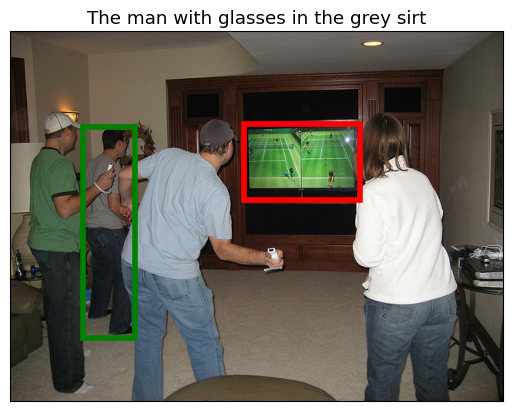

Intersection over Union (IoU):  0.0
B1:  [193.33655, 28.025803, 310.71765, 262.65692]
B2:  [48.2, 182.67, 136.88, 135.92]


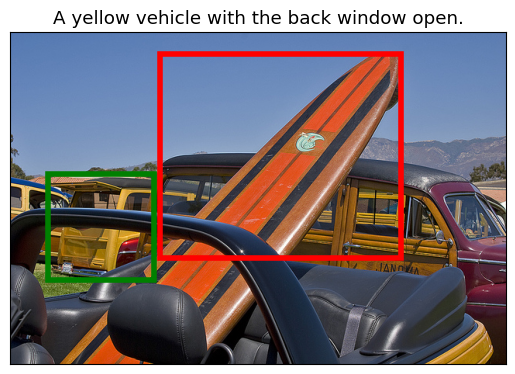

Intersection over Union (IoU):  0.0
B1:  [167.80487, 154.3488, 193.66931, 430.7397]
B2:  [329.79, 179.21, 98.21, 171.85]


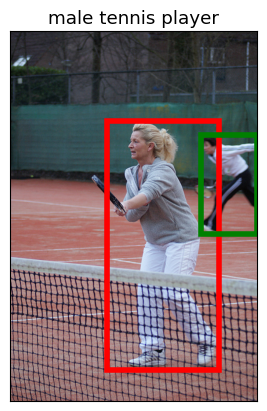

Intersection over Union (IoU):  0.057
B1:  [146.05154, 85.929016, 238.43097, 554.071]
B2:  [132.31, 52.97, 247.38, 581.04]


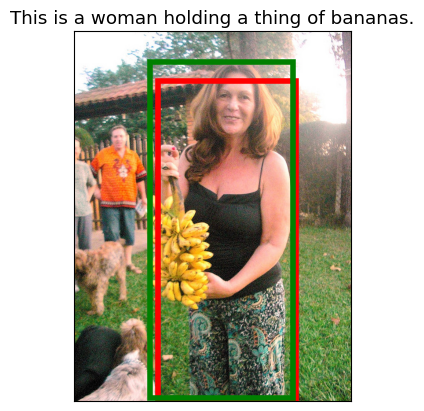

Intersection over Union (IoU):  0.866
B1:  [303.8767, 79.522354, 134.11615, 128.33292]
B2:  [350.18, 261.59, 289.82, 218.41]


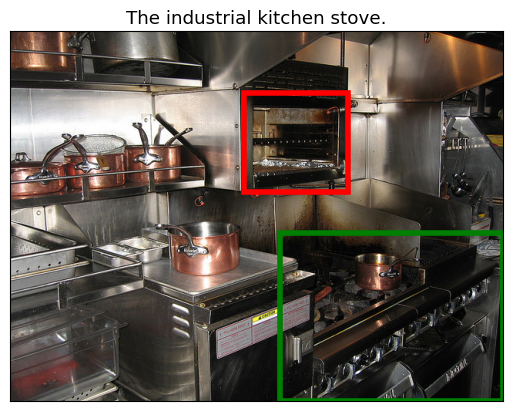

Intersection over Union (IoU):  0.0
B1:  [137.60364, 129.76675, 367.77496, 349.26172]
B2:  [134.53, 157.26, 402.51, 315.33]


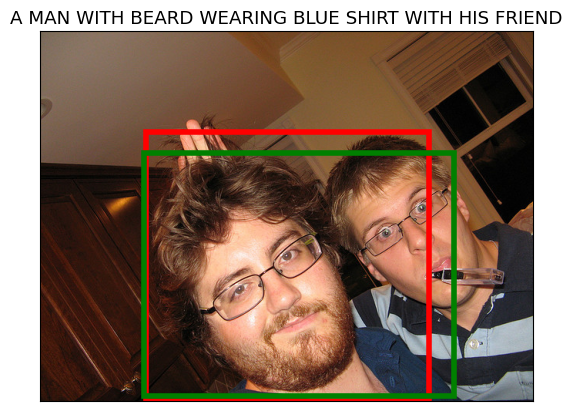

Intersection over Union (IoU):  0.832
B1:  [177.20665, 157.95811, 180.33229, 298.0865]
B2:  [34.91, 483.74, 280.93, 147.95]


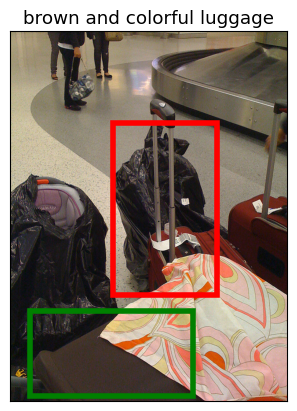

Intersection over Union (IoU):  0.0
B1:  [6.95578, 115.99097, 335.19275, 364.00903]
B2:  [3.1, 114.58, 394.32, 360.26]


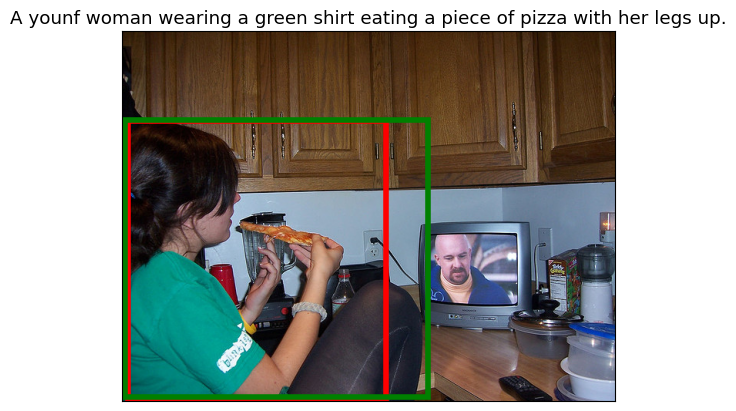

Intersection over Union (IoU):  0.837
Total Intersection over Union (IoU):  0.296
Total Precision:  0.3
Total Recall:  0.44


In [121]:
plot_image_bbox(best_bboxes,images,captions,ground_bbox)